In [22]:
import json
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image
import matplotlib.pyplot as plt
from glob import glob
import cv2

In [23]:
def visualize_map(train_waypoint, auto_waypoint, hand_waypoint, sub1, sub2, show_train=True, show_extra=True, show_hand=True, pred_is_path=False, dpi=100):
    map_floor = {'B2': -2, 'B1': -1, 'F1': 0, 'F2': 1, 'F3': 2, 'F4': 3, 'F5': 4, 'F6': 5, 'F7': 6, 'F8': 7, 'F9': 8,
                 '2B': -2, '1B': -1, '1F': 0, '2F': 1, '3F': 2, '4F': 3, '5F': 4, '6F': 5, '7F': 6, '8F': 7, '9F': 8}
 
    site_list = train_waypoint['site'].unique()

    # site loop
    for site in sorted(site_list):
        floor_list = sorted(glob(f'{DIR_META}{site}/*'))
        floor_list = [text.split('/')[-1] for text in floor_list]
        
        # 画像の比を決めるために一度floor_info.jsonを取得
        path_json = f'{DIR_META}{site}/{floor_list[0]}/floor_info.json'
        with open(path_json) as json_file:
            json_data = json.load(json_file)
        _width_meter = json_data["map_info"]["width"]
        _height_meter = json_data["map_info"]["height"]
        s = max(_width_meter, _height_meter)

        t_site_wp = train_waypoint.loc[train_waypoint['site']==site, :].reset_index(drop=True)
        a_site_wp = auto_waypoint.loc[auto_waypoint['site']==site, :].reset_index(drop=True)
        h_site_wp = hand_waypoint.loc[hand_waypoint['site']==site, :].reset_index(drop=True)
        s1_site_wp = sub1.loc[sub1['site']==site, :].reset_index(drop=True)
        s2_site_wp = sub2.loc[sub2['site']==site, :].reset_index(drop=True)
        
        # figとaxesの用意
        n_floor = len(floor_list)
        n_row = int(np.ceil(n_floor / 3))
        w = round(5*3*_width_meter/s)
        h = round(5*n_row*_height_meter/s)
        fig, axs = plt.subplots(n_row, 3, figsize=(w, h), dpi=dpi)
        # fig.suptitle(f'{site} (train:{len(t_site_wp)} extra:{len(a_site_wp)})', fontsize=15)
        fig.suptitle(f'{site} preds:{len(s1_site_wp)})', fontsize=15)
        fig.patch.set_facecolor('white')
        axs = axs.ravel()

        # floor loop
        for i_floor, floor in enumerate(floor_list):
            # json
            path_json = f'{DIR_META}{site}/{floor}/floor_info.json'
            with open(path_json) as json_file:
                json_data = json.load(json_file)
            width_meter = json_data["map_info"]["width"]
            height_meter = json_data["map_info"]["height"]

            # show image
            path_img = f'{DIR_META}{site}/{floor}/floor_image.png'
            im = Image.open(path_img)
            axs[i_floor].imshow(np.asarray(im), extent=(0, width_meter, 0, height_meter))
            
            t_wp = t_site_wp.loc[t_site_wp['floor']==map_floor[floor], :].reset_index(drop=True)
            a_wp = a_site_wp.loc[a_site_wp['floor']==map_floor[floor], :].reset_index(drop=True)
            h_wp = h_site_wp.loc[h_site_wp['floor']==map_floor[floor], :].reset_index(drop=True)

            # show waypoint
            if show_train:
                axs[i_floor].scatter(t_wp['x'], t_wp['y'], marker='o', color='red', s=1, label="train")
            if show_extra:
                # from IPython.core.debugger import Pdb; Pdb().set_trace()
                axs[i_floor].scatter(a_wp['x'], a_wp['y'], marker='o', color='green', s=1, label="extra")
            if show_hand:
                axs[i_floor].scatter(h_wp['x'], h_wp['y'], marker='o', color='blue', s=3, label="hand")
                
            s1_wp = s1_site_wp.loc[s1_site_wp['floor']==map_floor[floor], :].reset_index(drop=True)
            s2_wp = s2_site_wp.loc[s2_site_wp['floor']==map_floor[floor], :].reset_index(drop=True)
            if pred_is_path:
                for path, path_data in s1_wp.groupby("path"):
                    path_data.plot(x="x", y="y", style=".-", ax=axs[i_floor], alpha=0.5, color='orange', markersize=1, linewidth=1, legend=False)
                for path, path_data in s2_wp.groupby("path"):
                    path_data.plot(x="x", y="y", style=".-", ax=axs[i_floor], alpha=0.5,color='black',  markersize=1, linewidth=1, legend=False)
            else:
                axs[i_floor].scatter(s_wp['x'], s_wp['y'], marker='o', color='yellow', s=1, label="pred")
                
            axs[i_floor].set_title(f'{floor} (preds:{len(s1_wp)} hand:{len(h_wp)})', fontsize=10)
            # axs[i_floor].legend()
        plt.tight_layout()
        plt.savefig(f'./waypoint/{site}.png')
        plt.show()

In [24]:
DIR_META = "../input/indoor-location-navigation/metadata/"

train_waypoint = pd.read_csv('../input/indoor-location-train-waypoints/train_waypoints.csv')
hand_waypoint = pd.read_csv('../input/waypoint_by_hand.csv')

# fkubota ver
# extra grid
# LENGTH = 3
DISTANCE_LOWER = 3
DISTANCE_UPPER = 30
auto_waypoint = pd.read_csv(f'../input/extra_grids/df_extra_grid_edge_optim.csv')  # ここにextra gridを追加
auto_waypoint = auto_waypoint[(DISTANCE_LOWER < auto_waypoint['distance'])&(auto_waypoint['distance'] < DISTANCE_UPPER)].reset_index(drop=True)
map_floor = {'B2': -2, 'B1': -1, 'F1': 0, 'F2': 1, 'F3': 2, 'F4': 3, 'F5': 4, 'F6': 5, 'F7': 6, 'F8': 7, 'F9': 8,
             '2B': -2, '1B': -1, '1F': 0, '2F': 1, '3F': 2, '4F': 3, '5F': 4, '6F': 5, '7F': 6, '8F': 7, '9F': 8}
auto_waypoint['floor'] = auto_waypoint['floor'].replace(map_floor)
# 2kaido ver
# auto_waypoint = pd.read_csv(f'../input/auto_waypoint_v1.csv')  # ここにextra gridを追加

In [25]:
# site_list = train_waypoint['site'].unique()
# site = site_list[0]

In [26]:
EXP_NAME = "exp135"  # yellow  
# sub1 = pd.read_csv(f"../exp/{EXP_NAME}/{EXP_NAME}_cost_snap_sub.csv")
sub1 = pd.read_csv(f"../exp/{EXP_NAME}/{EXP_NAME}_noextra_sub.csv")
sub1["site"] = sub1["site_path_timestamp"].str.split("_", expand=True)[0]
sub1["path"] = sub1["site_path_timestamp"].str.split("_", expand=True)[1]
sub1["timestamp"] = sub1["site_path_timestamp"].str.split("_", expand=True)[2]


EXP_NAME = "exp138"  # black
sub2 = pd.read_csv(f"../exp/{EXP_NAME}/{EXP_NAME}_3stacking_4pp_12ensemble.csv")
sub2["site"] = sub2["site_path_timestamp"].str.split("_", expand=True)[0]
sub2["path"] = sub2["site_path_timestamp"].str.split("_", expand=True)[1]
sub2["timestamp"] = sub2["site_path_timestamp"].str.split("_", expand=True)[2]



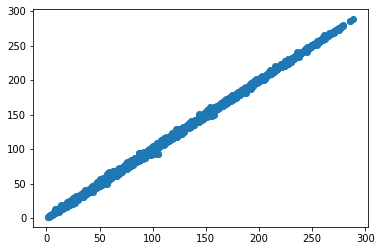

In [27]:
plt.scatter(sub1['x'], sub2['x'])

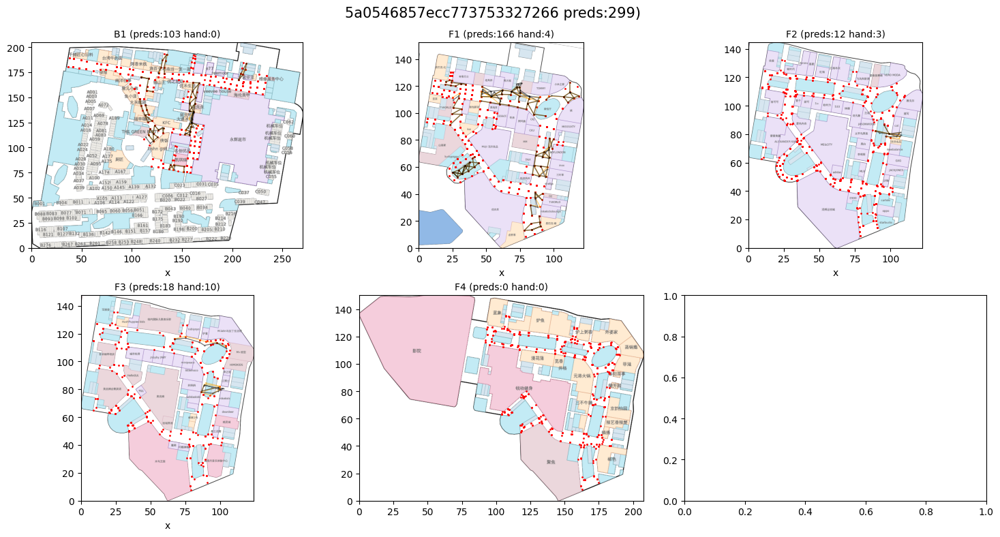

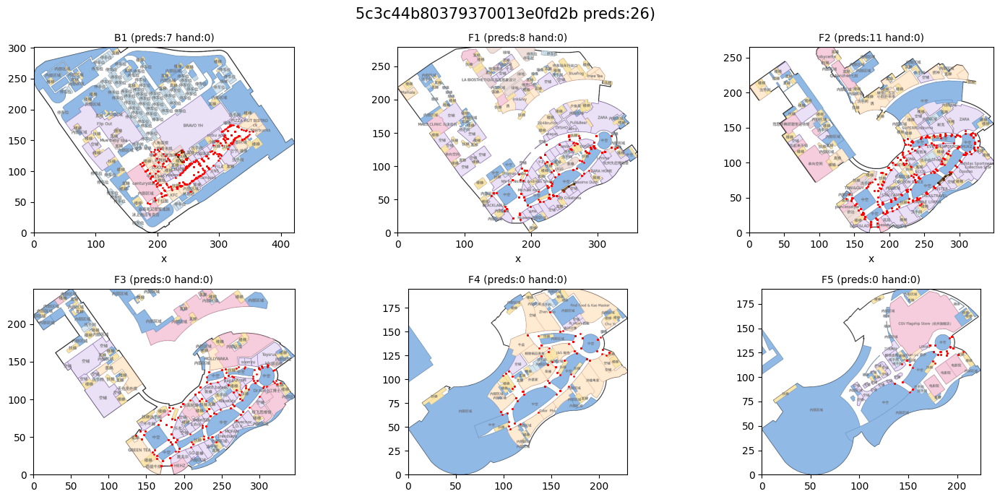

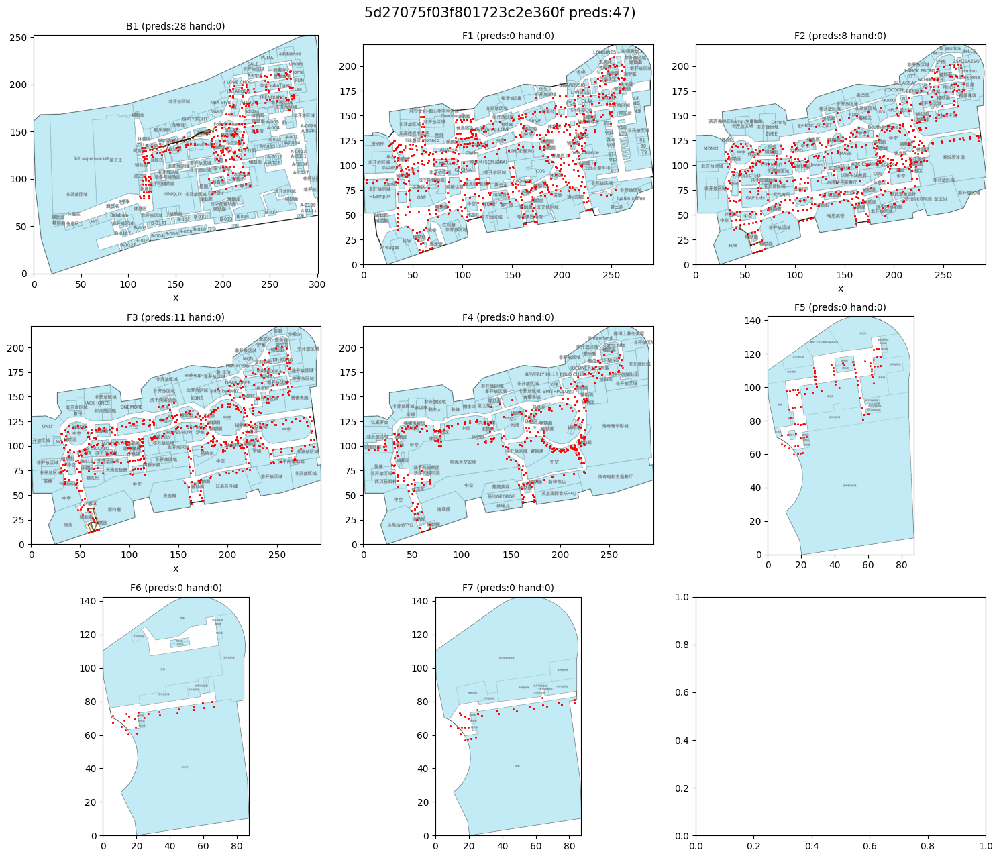

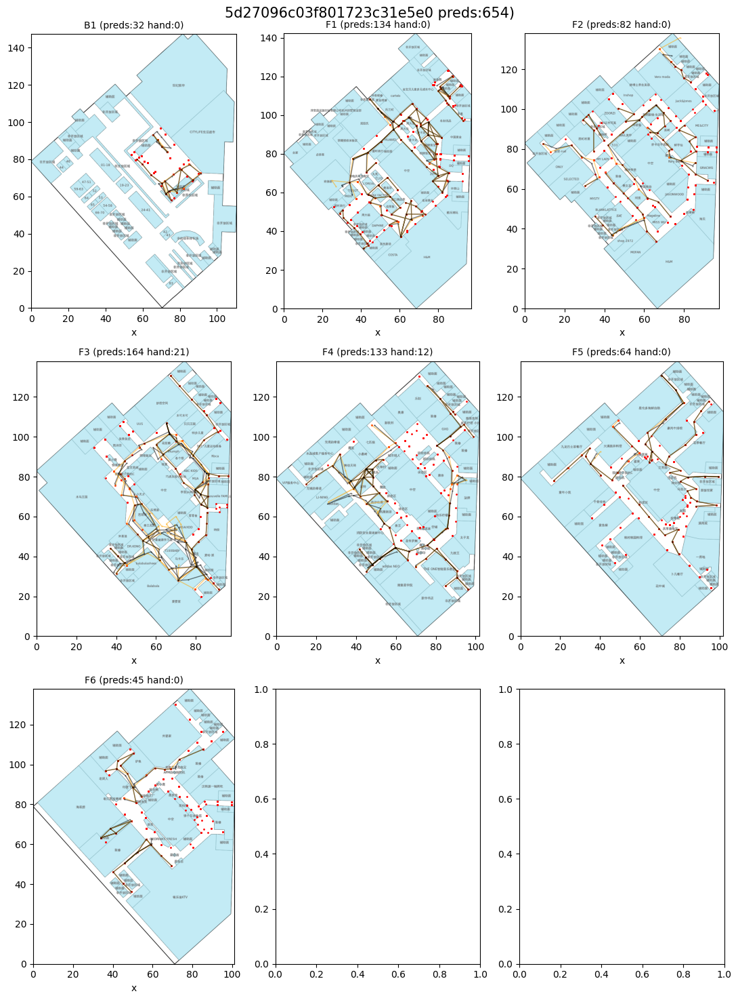

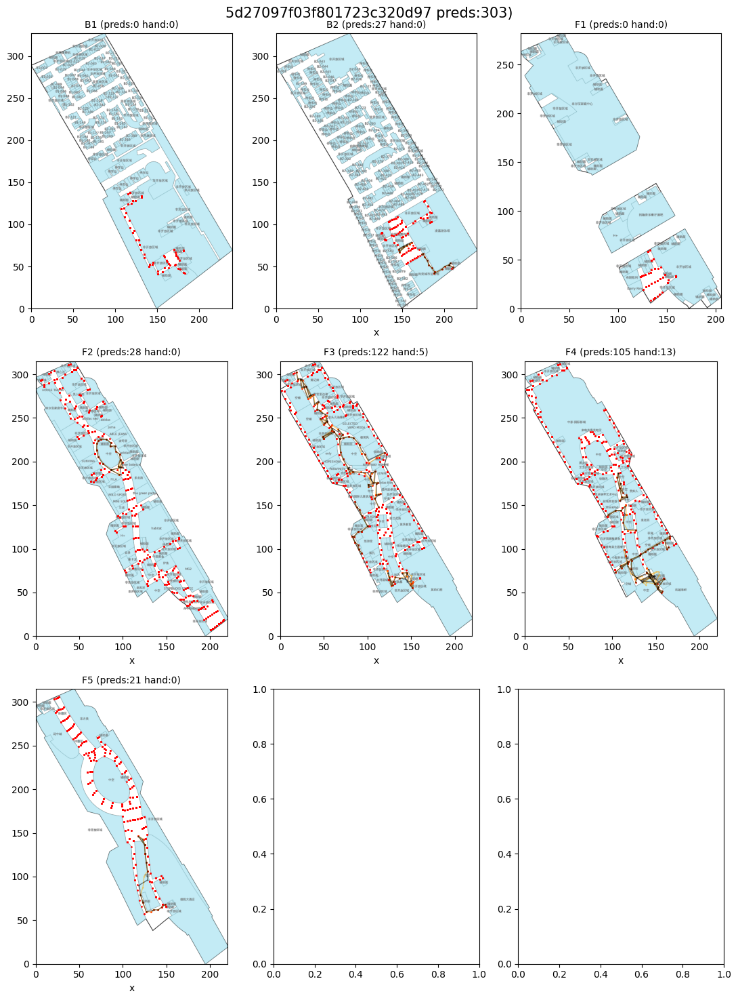

...

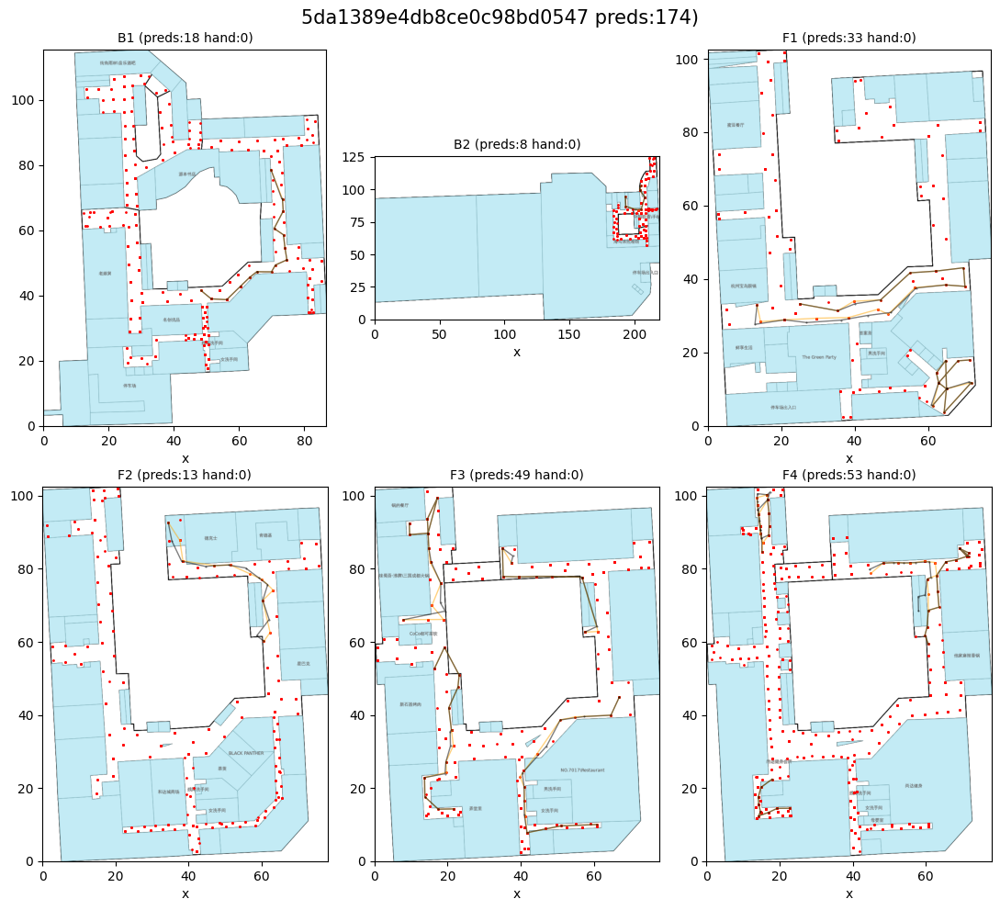

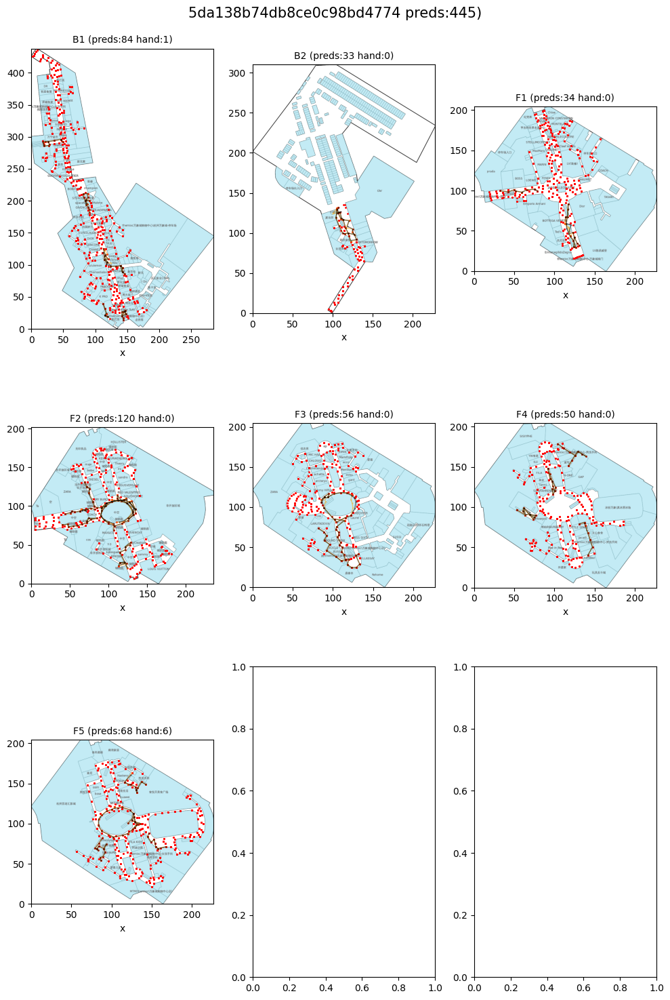

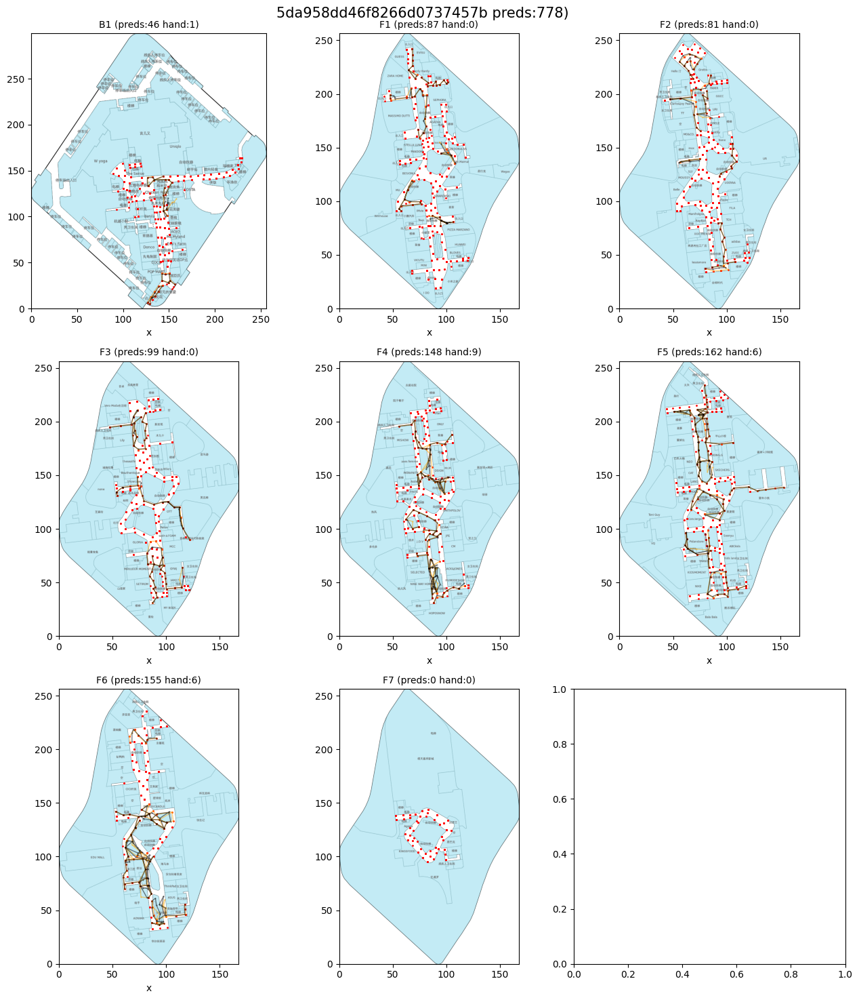

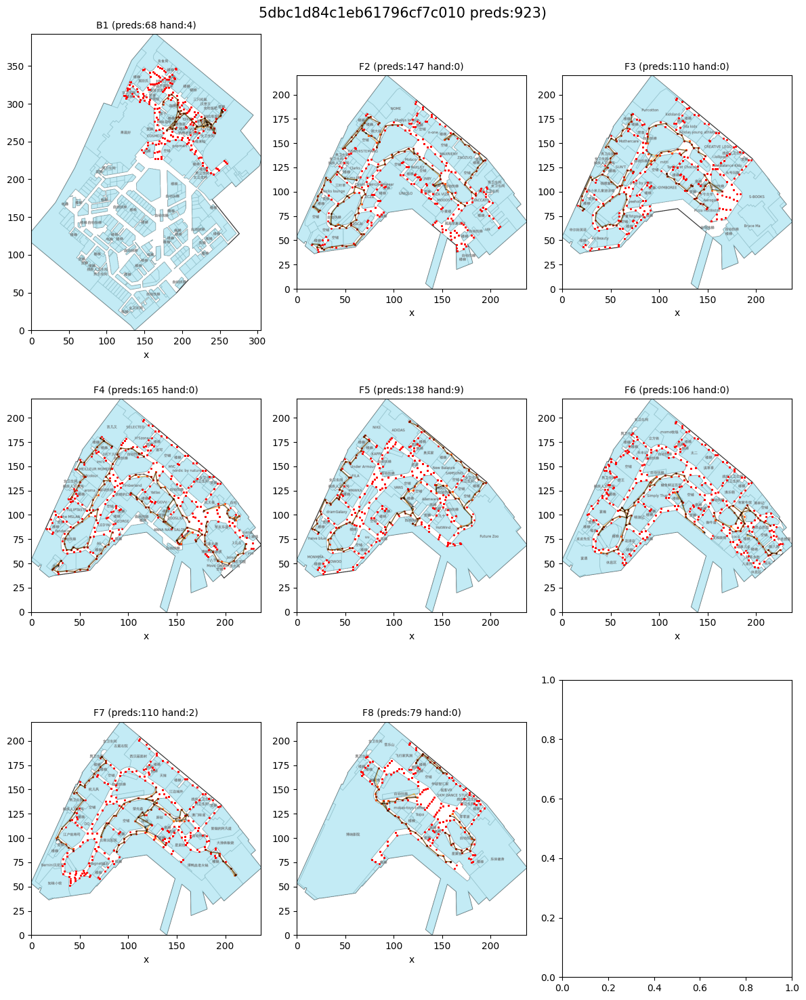

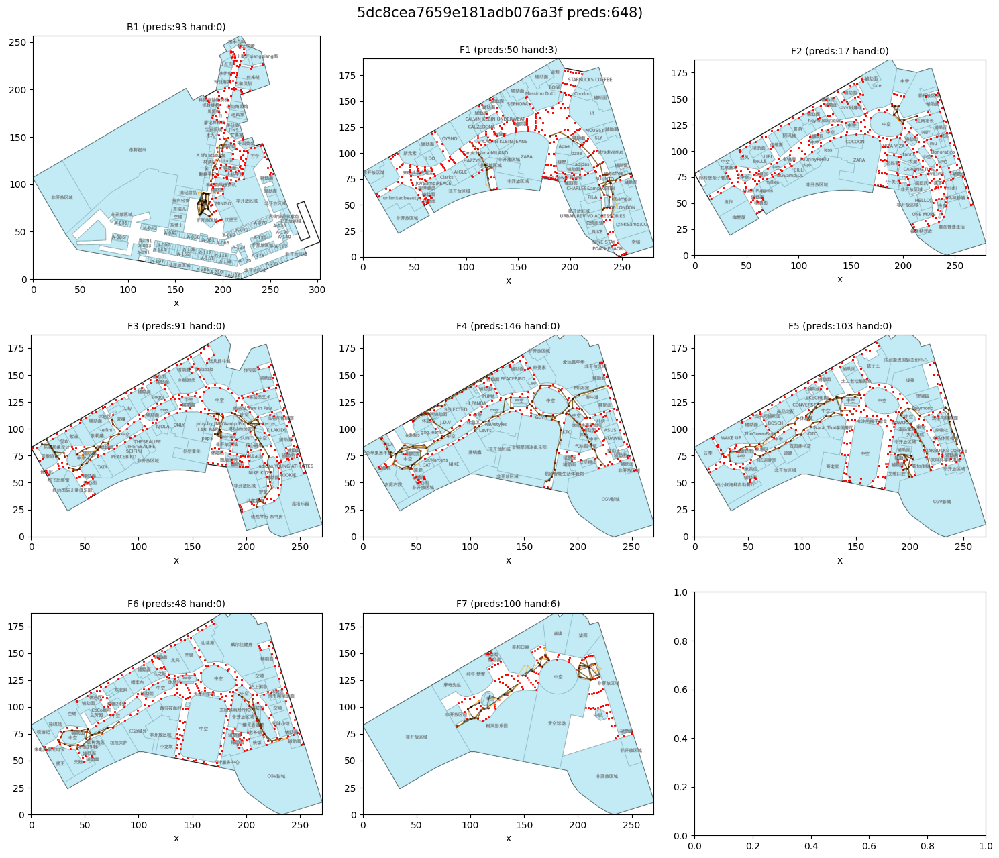

In [28]:
visualize_map(train_waypoint, auto_waypoint, hand_waypoint, sub1, sub2, show_hand=False, show_extra=False, pred_is_path=True)